In [1]:
# !wget https://www.openslr.org/resources/12/dev-clean.tar.gz -O /root/thesis-work/data/dev-clean.tar.gz

In [2]:
# import tarfile
# file = tarfile.open("./data/dev-clean.tar.gz")
# file.extractall('./data/speech')
# file.close()

In [3]:
# !pip install pydub
# !pip install matplotlib

In [1]:
file_path = './data/speech/LibriSpeech/dev-clean/7850/286674/7850-286674-0017.flac'

In [2]:
import soundfile as sf

data, samplerate = sf.read(file_path)

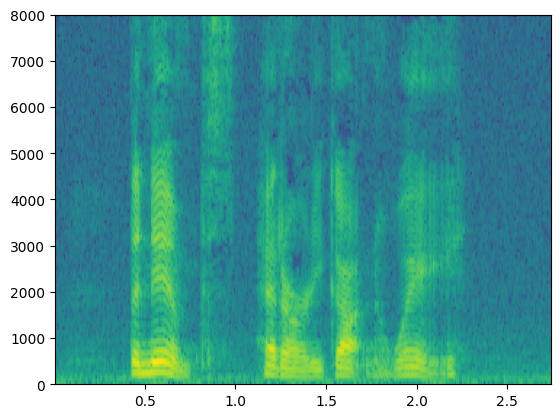

In [3]:
import matplotlib.pyplot as plt 

powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(data, Fs=samplerate) 
plt.show()

In [4]:
from IPython.display import Audio, display

In [8]:
Audio(file_path)

In [9]:
# !pip install scipy

<Figure size 1850x1050 with 0 Axes>

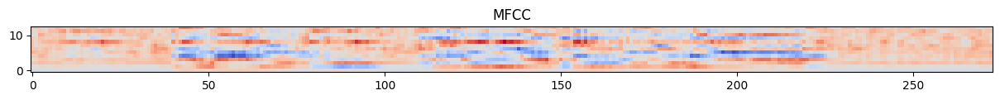

In [10]:
from python_speech_features import mfcc

mfcc_data = mfcc(data, samplerate)

import numpy as np
from matplotlib import cm

figg = plt.gcf()
figg.set_size_inches(18.5, 10.5)
# figg.savefig('test2png.png', dpi=100)

fig, ax = plt.subplots()
fig.set_size_inches(15, 10.5)
mfcc_data= np.swapaxes(mfcc_data, 0 ,1)
cax = ax.imshow(mfcc_data, interpolation='nearest', cmap=cm.coolwarm, origin='lower')
ax.set_title('MFCC')

plt.show()

In [34]:
import numpy as np
np.random.seed(42)

def noise_psd(N, psd = lambda f: 1):
        X_white = np.fft.rfft(np.random.randn(N));
        S = psd(np.fft.rfftfreq(N))
        # Normalize S
        S = S / np.sqrt(np.mean(S**2))
        X_shaped = X_white * S;
        return np.fft.irfft(X_shaped);

def PSDGenerator(f):
    return lambda N: noise_psd(N, f)

@PSDGenerator
def white_noise(f):
    return 1;

@PSDGenerator
def blue_noise(f):
    return np.sqrt(f);

@PSDGenerator
def violet_noise(f):
    return f;

@PSDGenerator
def brownian_noise(f):
    return 1/np.where(f == 0, float('inf'), f)

@PSDGenerator
def pink_noise(f):
    return 1/np.where(f == 0, float('inf'), np.sqrt(f))

@PSDGenerator
def general_noise(f, alpha = 1):
    return np.where(f==0 and alpha < 0, float('inf'), np.pow(f, alpha))

def plot_spectrum(s):
    f = np.fft.rfftfreq(len(s))
    return plt.loglog(f, np.abs(np.fft.rfft(s)))[0]

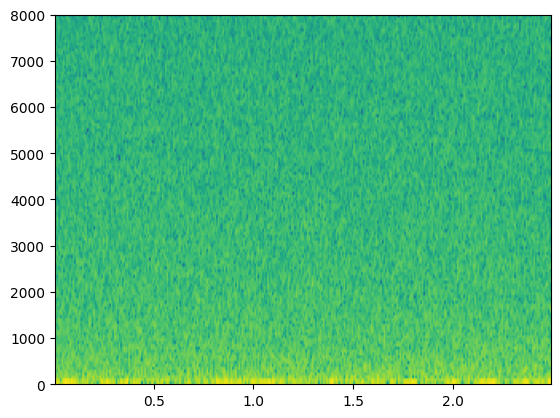

In [10]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(pink_noise(40000), Fs=samplerate) 
plt.show()

In [11]:
import colorednoise as cn
noise_audio = cn.powerlaw_psd_gaussian(1, 3277440)
noise_audio = noise_audio / max(abs(noise_audio))
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(highwat, Fs=16000)
plt.show()

NameError: name 'highwat' is not defined

In [32]:
Audio(data=highwat,rate=samplerate)

In [17]:
highwat, r = sf.read("./highway-14475.flac")
print(highwat.shape)

(3277440, 2)


In [18]:
highwat[0].shape
nnn = (highwat.T[0] + highwat.T[1])/2
nnn.shape

(3277440,)

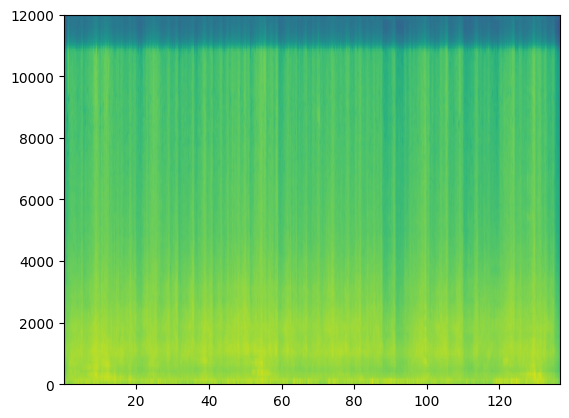

In [19]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(nnn, Fs=r)
plt.show()

In [17]:
Audio(data=nnn, rate=r)

In [20]:

ccc = nnn[:len(data)]
ccc.shape

(43920,)

22050


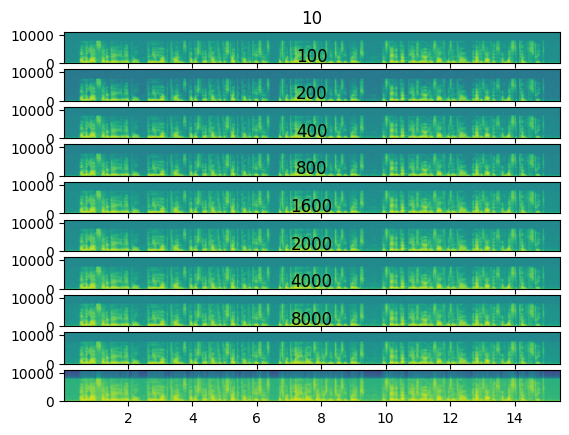

In [49]:
import pyplnoise
import soundfile as sf

# ccc = nnn[:len(data)]

# ccc = highwat[:len(data)]

# Define the length of the pink noise to match the audio
noise_length = len(data)

def getNewAudio(d, fmax: float, desired_noise_level = 0.001):
    # # Generate pink noise
    pink_noise = pyplnoise.PinkNoise(samplerate, 10e-2, fmax, seed=42).get_series(len(d))

    # Calculate the scaling factor based on the desired noise level
    scaling_factor = desired_noise_level / max(abs(pink_noise))

    # Scale the pink noise
    pink_noise_scaled = pink_noise * scaling_factor

    # Add the pink noise to the audio
    return d + pink_noise_scaled
    # return ccc + data
    
print(samplerate)

# audio_with_pink_noise = getNewAudio(2000.)
# audio_with_pink_noise2 = getNewAudio(400.)

# # Audio(audio_with_pink_noise)
# plt.subplot(211)
# powerSpectrum2, frequenciesFound2, time2, imageAxis2 = plt.specgram(audio_with_pink_noise, Fs=samplerate) 
# plt.subplot(212)
# powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(audio_with_pink_noise2, Fs=samplerate) 

q = (10, 100, 200, 400, 800, 1600, 2000, 4000, 8000)

c = 0
fig, axs = plt.subplots(len(q) + 1)
for i in q:
    audio_with_pink_noise = getNewAudio(data, i)
    powerSpectrum2, frequenciesFound2, time2, imageAxis2 = axs[c].specgram(audio_with_pink_noise, Fs=samplerate) 
    axs[c].set_title(q[c])
    c += 1

powerSpectrum, frequenciesFound, time, imageAxis = axs[-1].specgram(data, Fs=samplerate) 
    
plt.show()

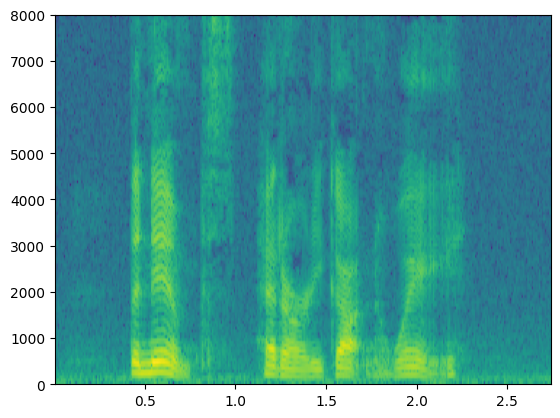

In [42]:
audio_noise = getNewAudio(8000, desired_noise_level=0.01)
audio_noise_2 = data + getNewAudio(8000, desired_noise_level=0.0001)
plt.specgram(audio_noise_2, Fs=samplerate) 
plt.show()

In [36]:
Audio(data=audio_with_pink_noise, rate=samplerate)
# Audio(data=audio_with_pink_noise, rate=samplerate)

<Figure size 1850x1050 with 0 Axes>

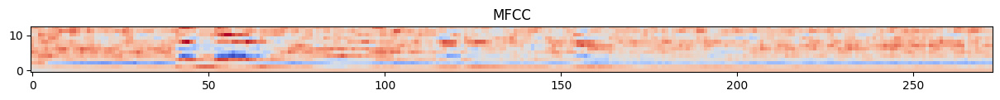

In [37]:
from python_speech_features import mfcc

mfcc_data = mfcc(audio_with_pink_noise, samplerate)

import numpy as np
from matplotlib import cm

figg = plt.gcf()
figg.set_size_inches(18.5, 10.5)
# figg.savefig('test2png.png', dpi=100)

fig, ax = plt.subplots()
# fig.set_size_inches(15, 10.5)
mfcc_data= np.swapaxes(mfcc_data, 0 ,1)
cax = ax.imshow(mfcc_data, interpolation='nearest', cmap=cm.coolwarm, origin='lower')
ax.set_title('MFCC')

plt.show()

In [12]:
import librosa

highwat, r = librosa.load("./highway-14475.flac", sr=16000)
print(highwat.shape)

(2184960,)


In [14]:
# !pip install librosa

In [15]:
# !pip install Cython
# !pip install pydsm

In [16]:
# !apt-cache search openblas
# !sudo apt-get install libfoo-dev

In [22]:
audio_test = getNewAudio(100)

In [23]:
pre_emphasis = 0.97
emphasized_audio = np.append(audio_test[0], audio_test[1:] - pre_emphasis * audio_test[:-1])


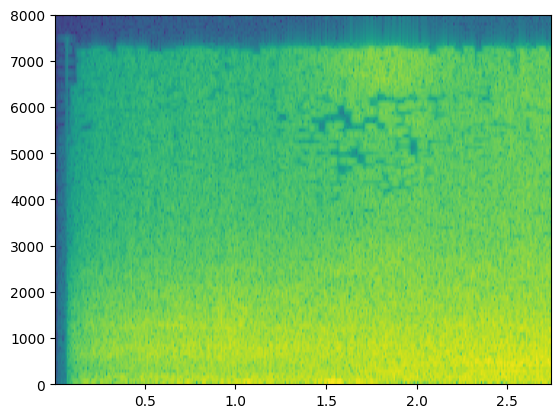

In [32]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(ccc, Fs=samplerate)
plt.show()

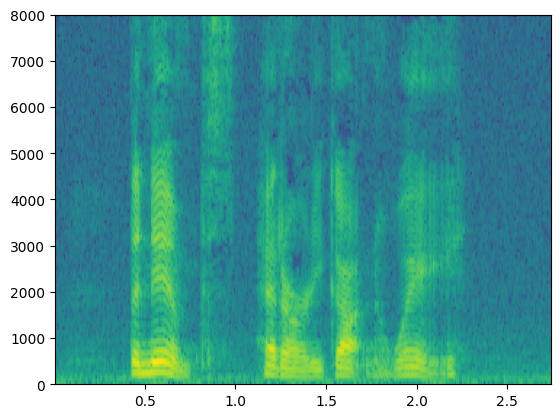

In [31]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(data, Fs=samplerate)
plt.show()

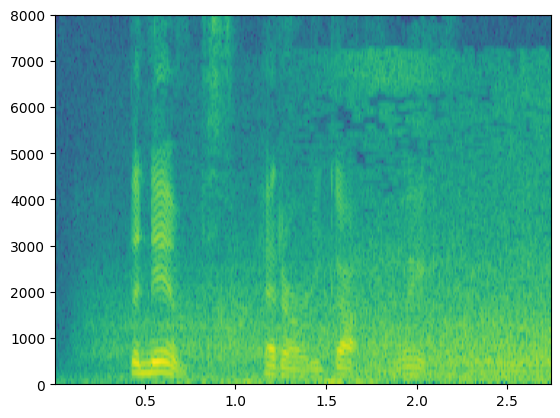

In [30]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(audio_test, Fs=samplerate)
plt.show()

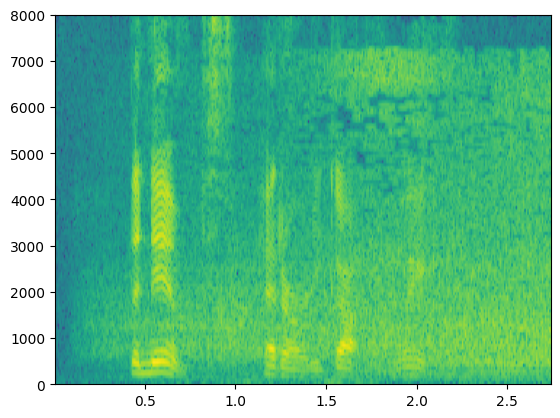

In [27]:
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(emphasized_audio, Fs=samplerate)
plt.show()

In [29]:
Audio(data=emphasized_audio, rate=samplerate)

In [32]:
i = 0
for el in dataloader:
    print(el)
    i+=1
    if i > 10:
        break
    

2023-06-03 15:22:29.407013: I tensorflow/core/common_runtime/executor.cc:1197] [/device:CPU:0] (DEBUG INFO) Executor start aborting (this does not indicate an error and you can ignore this message): INVALID_ARGUMENT: You must feed a value for placeholder tensor 'Placeholder/_0' with dtype int32
	 [[{{node Placeholder/_0}}]]


In [33]:
a = dataloader.get_single_element()

InvalidArgumentError: {{function_node __wrapped__DatasetToSingleElement_output_types_2_device_/job:localhost/replica:0/task:0/device:CPU:0}} Dataset was empty. [Op:DatasetToSingleElement]

In [24]:
a

NameError: name 'a' is not defined

In [2]:
import keras

2023-06-04 10:25:39.475725: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-06-04 10:25:40.149828: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-06-04 10:25:40.152021: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-06-04 10:25:42.273313: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [3]:
dir(keras)

['Input',
 'Model',
 'Sequential',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 '__version__',
 '_keras_api_constants',
 '_keras_api_constants_v1',
 'activations',
 'backend',
 'backend_config',
 'callbacks',
 'constraints',
 'distribute',
 'dtensor',
 'engine',
 'initializers',
 'keras_export',
 'layers',
 'losses',
 'metrics',
 'mixed_precision',
 'models',
 'optimizers',
 'protobuf',
 'regularizers',
 'saving',
 'tf2',
 'utils']

In [2]:
import preprocessors

In [3]:
import transformers

In [8]:
!pip install pandas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 22.5 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 341.8/341.8 kB 26.5 MB/s eta 0:00:00


In [23]:
import importlib
import preprocessors
importlib.reload(preprocessors)

<module 'preprocessors' from '/root/thesis-work/preprocessors.py'>

In [1]:
importlib.reload(data_preparer)
import data_preparer

dataset = data_preparer.getDataset()

In [51]:
# !pip install tqdm

In [33]:
print(len(dataset))
print(len(all_transcriptions.splitlines()))
print(len(audios_paths))

2703
2703
2704


In [59]:
import preprocessors

In [24]:
importlib.reload(preprocessors)
from preprocessors import AudioReader
for i in range(100):
    # q = WavReader.get_spectrogram(dataset[i][0], 256, 160, 384)
    q = AudioReader.get_mfcc(dataset[i][0])
    # print(q.shape)

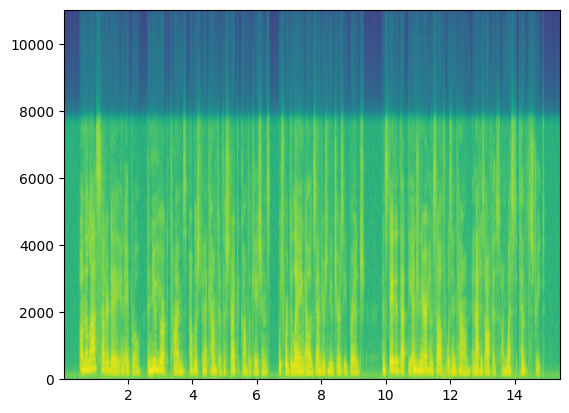

22050


In [2]:
import matplotlib.pyplot as plt
import numpy as np
import librosa
data = np.array([])
spectrogram = dataset[0][0]
samplerate=None
if isinstance(spectrogram, str):
    data, sr = librosa.load(spectrogram)
    if samplerate is None:
        samplerate = sr
else:
    data = spectrogram
    if samplerate is None:
        samplerate = 16000
powerSpectrum, frequenciesFound, time, imageAxis = plt.specgram(data, Fs=samplerate)
plt.show()
print(samplerate)

In [15]:
from IPython.display import Audio
Audio(data=aa, rate=16000)

In [10]:
samplerate

22050

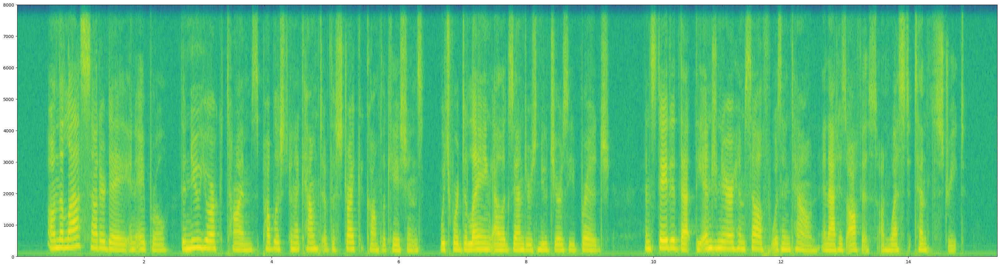

In [33]:
aa = librosa.resample(data, orig_sr=sr,target_sr=16000)
fig = plt.gcf()
fig.set_size_inches(40.5, 10.5)
AudioReader.plot_spectrogram(aa, samplerate=16000)

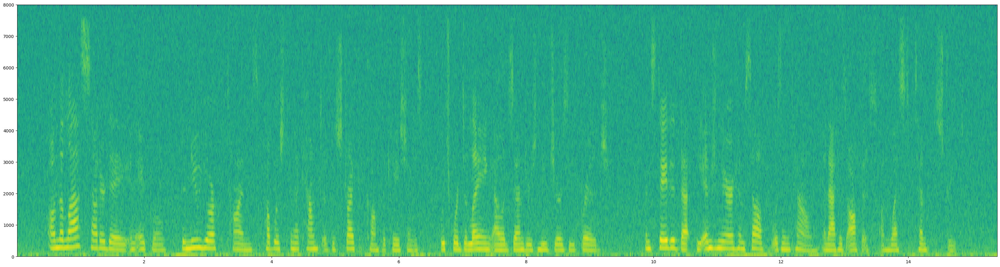

In [60]:
t = getNewAudio(aa, 8000, desired_noise_level=0.1)
fig = plt.gcf()
fig.set_size_inches(40.5, 10.5)
AudioReader.plot_spectrogram(t, samplerate=16000)
Audio(t, rate=16000)

In [91]:
dataset[0][0].resolve()

PosixPath('/root/thesis-work/data/speech/LibriSpeech/dev-clean/1462/170145/1462-170145-0000.flac')

In [110]:
dataset[0][0]

'/root/thesis-work/data/speech/LibriSpeech/dev-clean/1462/170145/1462-170145-0000.flac'

In [17]:
q, b = librosa.load(dataset[5][0])
b

22050

In [ ]:
t = getNewAudio(